# Business Context

Instead of waking to overlooked "Do not disturb" signs, Airbnb travelers find themselves rising with the birds in a whimsical treehouse, having their morning coffee on the deck of a houseboat, or cooking a shared regional breakfast with their hosts.

New users on Airbnb can book a place to stay in 34,000+ cities across 190+ countries. By accurately predicting where a new user will book their first travel experience, Airbnb can share more personalized content with their community, decrease the average time to first booking, and better forecast demand.

# Business Challange

In this project, I was challenged to predict in which country a new user will make his or her first booking.


# Business Understanding

- Business model:
     Marketplace -> Connecting people that offer accommodation, to the person who's looking for accommodation.
    
    
- Model Offer:
     People offering them property temporarily.
     
- Metrics:  Portfolio Size, Portfolio diversity/density.

- Demand: How many people are looking for accommodation; 

    - User number.
    - LTV ( Lifetime Value)
    - CAC ( Client Acquisition Cost )
    
    - Gross Revenue =  ( fee * number of clients ) - CAC

# Solution Planning

- Prediction model of the first destination of a new user
- Prediction saved in a database table.
- API:

    - Imput: Users and their characteristics;
    - output: Users and their characteristics with the destination prediction.

# 0.1 Imports

In [409]:
import random 
import warnings
import pandas  as pd
import seaborn as sns
import numpy   as np

from matplotlib  import pyplot          as plt
from scipy       import stats           as ss
from keras       import layers          as l
from keras       import models          as ml
from sklearn     import metrics         as m
from sklearn     import preprocessing   as pp
from sklearn     import model_selection as ms
from scikitplot  import metrics         as mt
from imblearn    import under_sampling  as us
from imblearn    import over_sampling   as os
from imblearn    import combine         as c

import matplotlib.pyplot    as plt

from pandas_profiling            import ProfileReport
from category_encoders           import TargetEncoder
from IPython.core.display        import HTML

warnings.filterwarnings ('ignore')

## 0.02 Helper Functions

In [41]:
def jupyter_settings(): 
    %matplotlib inline 
    #%matplotlib notebook
    %pylab inline
    
    plt.style.use('bmh')
    plt.rcParams['figure.figsize'] = [25, 12]
    plt.rcParams['font.size'] = 24
    
     
    display( HTML( '<style>.container { width:100% !important; }</style>') )
    pd.options.display.max_columns = None
    pd.options.display.max_rows = None
    pd.set_option ('display.expand_frame_repr', False)
    
    sns.set()

%matplotlib inline 
%matplotlib notebook

plt.style.use('bmh')
plt.rcParams['figure.figsize'] = [25, 12]
plt.rcParams['font.size'] = 24


display( HTML( '<style>.container { width:100% !important; }</style>') )
pd.options.display.max_columns = None
pd.options.display.max_rows = None
pd.set_option ('display.expand_frame_repr', False)

sns.set()

jupyter_settings()

# ===============================================
def cramer_v (x, y):
    cm = pd.crosstab(x, y).values
    n = cm.sum()
    r, k = cm.shape
    
    chi2 = ss.chi2_contingency (cm)[0]
    chi2corr = max (0, chi2 - (k-1)*(r-1)/(n-1) )
    
    kcorr = k - (k-1)**2/(n-1) 
    rcorr = r - (r-1)**2/(n-1) 

    return  np.sqrt( (chi2corr/n) / (min ( kcorr-1, rcorr-1) ) )

#=================================================


def fxn():
    warnings.warn("deprecated", DeprecationWarning)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    fxn()

%pylab is deprecated, use %matplotlib inline and import the required libraries.
Populating the interactive namespace from numpy and matplotlib


# 1.0  Data Description

## 1.1 Loading data

In [57]:
df1 = pd.read_csv('/Users/adriele/Documents/repos/pa001/dataset/train_users.csv')

df_sessions = pd.read_csv('/Users/adriele/Documents/repos/pa001/dataset/sessions.csv')


## 1.2 Data Dimensions

In [58]:
print( 'Number of Cols {}'.format( df1.shape[1] ) )
print( 'Number of Rows {}'.format( df1.shape[0] ) )


Number of Cols 16
Number of Rows 213451


In [59]:
print( 'Number of Cols {}'.format( df_sessions.shape[1] ) )
print( 'Number of Rows {}'.format( df_sessions.shape[0] ) )



Number of Cols 6
Number of Rows 10567737


## 1.3 Check Na's

In [60]:
df1.isna().sum()

id                              0
date_account_created            0
timestamp_first_active          0
date_first_booking         124543
gender                          0
age                         87990
signup_method                   0
signup_flow                     0
language                        0
affiliate_channel               0
affiliate_provider              0
first_affiliate_tracked      6065
signup_app                      0
first_device_type               0
first_browser                   0
country_destination             0
dtype: int64

In [61]:
df1['country_destination' ].value_counts( normalize=True )

NDF      0.583473
US       0.292226
other    0.047290
FR       0.023532
IT       0.013282
GB       0.010888
ES       0.010536
CA       0.006690
DE       0.004971
NL       0.003570
AU       0.002525
PT       0.001017
Name: country_destination, dtype: float64

In [62]:
# removing missing values
#df1 = df1.dropna()
#========================== User ===============================

# date_first_booking
date_first_booking_max = pd.to_datetime( df1['date_first_booking'] ).max().strftime( '%Y-%m-%d')
df1['date_first_booking'] = df1['date_first_booking'].fillna(date_first_booking_max)

# Age
avg_age = df1['age'].mean().astype( int )
df1['age'] = df1['age'].fillna( avg_age )

# first_affiliate_tracked

df1 = df1[~df1['first_affiliate_tracked'].isna()]

# ======================= sessions ===============================

# user id 0.3%
df_sessions = df_sessions[~df_sessions['user_id'].isna() ]

# Action 0.7%
df_sessions = df_sessions[~df_sessions['action'].isna() ]

# action_type 11%
df_sessions = df_sessions[~df_sessions['action_type'].isna() ]

# action_detail 11%
df_sessions = df_sessions[~df_sessions['action_detail'].isna() ]

# secs_elapsed 1.2%
df_sessions = df_sessions[~df_sessions['secs_elapsed'].isna() ]



## 1.4 Data Types

In [63]:
df1.dtypes

id                          object
date_account_created        object
timestamp_first_active       int64
date_first_booking          object
gender                      object
age                        float64
signup_method               object
signup_flow                  int64
language                    object
affiliate_channel           object
affiliate_provider          object
first_affiliate_tracked     object
signup_app                  object
first_device_type           object
first_browser               object
country_destination         object
dtype: object

## 1.5 Change Dtypes

In [64]:
#date_account_created
df1['date_account_created'] = pd.to_datetime( df1['date_account_created'] )

#timestamp_first_active
df1['timestamp_first_active'] = pd.to_datetime( df1['timestamp_first_active'], format='%Y%m%d%H%M%S' )

#date_first_booking
df1['date_first_booking'] = pd.to_datetime( df1['date_first_booking'] )


#age
df1['age'] = df1['age'].astype( int )


df1.dtypes

id                                 object
date_account_created       datetime64[ns]
timestamp_first_active     datetime64[ns]
date_first_booking         datetime64[ns]
gender                             object
age                                 int64
signup_method                      object
signup_flow                         int64
language                           object
affiliate_channel                  object
affiliate_provider                 object
first_affiliate_tracked            object
signup_app                         object
first_device_type                  object
first_browser                      object
country_destination                object
dtype: object

## 1.6 Check Balanncing Data

In [65]:
df1['country_destination'].value_counts( normalize=True )

NDF      0.579673
US       0.294461
other    0.048128
FR       0.023623
IT       0.013458
GB       0.011066
ES       0.010671
CA       0.006707
DE       0.005020
NL       0.003621
AU       0.002541
PT       0.001032
Name: country_destination, dtype: float64

## 1.7 Descriptive Analysis

### 1.7.1 General

In [66]:
# Users
num_attributes = df1.select_dtypes( include=[ 'int64', 'float64' ] )
cat_attributes = df1.select_dtypes( exclude=[ 'int64', 'float64', 'datetime64[ns]' ] )
time_attributes = df1.select_dtypes( include=[ 'datetime64[ns]'  ] )

# sessions
num_attributes_sessions = df_sessions.select_dtypes( include=[ 'int64', 'float64' ] )
cat_attributes_sessions = df_sessions.select_dtypes( exclude=[ 'int64', 'float64', 'datetime64[ns]' ] )
time_attributes_sessions = df_sessions.select_dtypes( include=[ 'datetime64[ns]'  ] )

### 1.7.2 Numerical Users

In [67]:
# Central tendency - Mean, mediana
ct1 = pd.DataFrame( num_attributes.apply( np.mean ) ).T
ct2 = pd.DataFrame( num_attributes.apply( np.median ) ).T

# dispensions- STD, Min, Max, Range, Slkew, Kurtosis
d1 = pd.DataFrame( num_attributes.apply( np.mean ) ).T
d2 = pd.DataFrame( num_attributes.apply( min) ).T
d3 = pd.DataFrame( num_attributes.apply( max ) ).T
d4 = pd.DataFrame( num_attributes.apply(lambda x: x.max() - x.min() ) ).T
d5 = pd.DataFrame( num_attributes.apply(lambda x: x.skew() ) ).T
d6 = pd.DataFrame( num_attributes.apply(lambda x: x.kurtosis() ) ).T


# Concat
ct = pd.concat( [ d2, d3, d4, ct1, ct2, d1, d5, d6 ] ).T.reset_index()
ct.columns= ['attributes', 'min', 'max', 'range', 'mean', 'median', 'std', 'skew', 'kurtosis' ]
ct

,attributes,min,max,range,mean,median,std,skew,kurtosis
0,age,1.0,2014.0,2013.0,49.183142,49.0,49.183142,16.333820,267.655434
1,signup_flow,0.0,25.0,25.0,3.151490,0.0,3.151490,2.287158,3.567794


### 1.7.3 Categorical - User


In [68]:
cat_attributes.drop( 'id', axis=1 ).describe()

,gender,signup_method,language,affiliate_channel,affiliate_provider,first_affiliate_tracked,signup_app,first_device_type,first_browser,country_destination
count,207386,207386,207386,207386,207386,207386,207386,207386,207386,207386
unique,4,3,25,8,18,7,4,9,52,12
top,-unknown-,basic,en,direct,direct,untracked,Web,Mac Desktop,Chrome,NDF
freq,91783,148297,200415,134179,133935,109232,178334,89600,63845,120216


### 1.7.4 Numerical - Sessions

In [69]:
# Central tendency - Mean, mediana
ct1 = pd.DataFrame( num_attributes_sessions.apply( np.mean ) ).T
ct2 = pd.DataFrame( num_attributes_sessions.apply( np.median ) ).T

# dispensions- STD, Min, Max, Range, Slkew, Kurtosis
d1 = pd.DataFrame( num_attributes_sessions.apply( np.mean ) ).T
d2 = pd.DataFrame( num_attributes_sessions.apply( min) ).T
d3 = pd.DataFrame( num_attributes_sessions.apply( max ) ).T
d4 = pd.DataFrame( num_attributes_sessions.apply(lambda x: x.max() - x.min() ) ).T
d5 = pd.DataFrame( num_attributes_sessions.apply(lambda x: x.skew() ) ).T
d6 = pd.DataFrame( num_attributes_sessions.apply(lambda x: x.kurtosis() ) ).T


# Concat
ct = pd.concat( [ d2, d3, d4, ct1, ct2, d1, d5, d6 ] ).T.reset_index()
ct.columns= ['attributes', 'min', 'max', 'range', 'mean', 'median', 'std', 'skew', 'kurtosis' ]
ct

,attributes,min,max,range,mean,median,std,skew,kurtosis
0,secs_elapsed,0.0,1799977.0,1799977.0,19961.8251,1369.0,19961.8251,11.137761,154.84312


### 1.7.4 Categorical - Sessions

In [70]:
cat_attributes_sessions.drop( 'user_id', axis=1 ).describe()

,action,action_type,action_detail,device_type
count,9213930,9213930,9213930,9213930
unique,347,10,155,14
top,show,view,view_search_results,Mac Desktop
freq,2178382,3545621,1770931,3019523


In [71]:
# attrivute list for Cramer's V correlation
cat_attributes_list = cat_attributes_sessions.drop( 'user_id', axis=1 ).columns.tolist()

corr_dict = {}
for i in range( len( cat_attributes_list )):
    corr_list = []
    for j in range( len( cat_attributes_list)):
        ref = cat_attributes_list[i]
        feat = cat_attributes_list[j]
        
        # Correlation
        corr = cramer_v( cat_attributes_sessions[ ref ], cat_attributes_sessions[ feat ])
        
        # append to list
        corr_list.append( corr )
        
     # Append the correlation list to each ref attributes   
    corr_dict[ ref ] = corr_list

<AxesSubplot: >

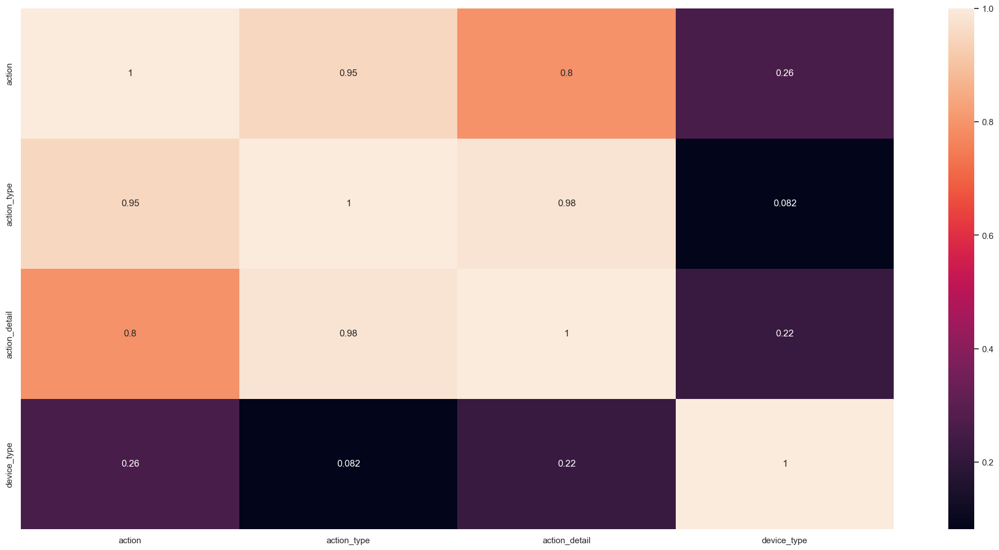

In [72]:
d = pd.DataFrame( corr_dict )
d = d.set_index( d.columns )
sns.heatmap( d, annot=True )

# 2.0 Data Filtering

In [131]:
df2 = df1.copy()
df2_ses = df_sessions.copy()
df2.columns

Index(['id', 'date_account_created', 'timestamp_first_active',
       'date_first_booking', 'gender', 'age', 'signup_method', 'signup_flow',
       'language', 'affiliate_channel', 'affiliate_provider',
       'first_affiliate_tracked', 'signup_app', 'first_device_type',
       'first_browser', 'country_destination'],
      dtype='object')

## 2.1 Creat New Features

In [132]:
# Days from first active up to first booking
df2['first_active'] = pd.to_datetime( df2['timestamp_first_active'].dt.strftime( '%Y-%m-%d' ) )
df2['days_from_first_active_untill_booking'] = (df2['date_first_booking'] - df2['first_active']).apply( lambda x: x.days )


# Days from first active up to account created
df2['days_from_first_active_untill_account_created'] = (df2['date_account_created'] - df2['first_active']).apply( lambda x: x.days )

# Days from account created  up to first book
df2['days_from_account_created_untill_first_booking'] = (df2['date_first_booking'] - df2['date_account_created'] ).apply( lambda x: x.days )


# ====================   First active ================================
# year of first active
df2['year_first_active'] = df2['first_active'].dt.year

# month of first active
df2['month_first_active'] = df2['first_active'].dt.month

# day of first active
df2['day_first_active'] = df2['first_active'].dt.day

# day of week first active
df2['day_of_week__first_active'] = df2['first_active'].dt.dayofweek

# week of year of first active
df2['week_of_year_first_active'] = df2['first_active'].dt.weekofyear


# ========================= First Booking ===========================

# year of first booking
df2['year_first_booking'] = df2['date_first_booking'].dt.year

# month of first booking
df2['month_first_booking'] = df2['date_first_booking'].dt.month

# day of first booking
df2['day_first_booking'] = df2['date_first_booking'].dt.day

# day of week first booking
df2['day_of_week_first_booking'] = df2['date_first_booking'].dt.dayofweek

# week of year of first booking
df2['week_of_year_first_booking'] = df2['date_first_booking'].dt.weekofyear


# ======================= Account Created ==============================

# year of account created
df2['year_account_created'] = df2['date_account_created'].dt.year

# month of account created
df2['month_account_created'] = df2['date_account_created'].dt.month

# day of account created
df2['day_account_created'] = df2['date_account_created'].dt.day

# day of week account created
df2['day_of_week_account_created'] = df2['date_account_created'].dt.dayofweek

# week of year of account created
df2['week_of_year_account_created'] = df2['date_account_created'].dt.weekofyear



In [133]:
df2.shape

(207386, 35)

## 2.2 Columns Selection

# 3.0 Data Filtering

In [134]:
df3 = df2.copy()
df3_ses = df2_ses.copy()

## 3.1 Filtering Row

In [135]:
# Age - There are few people over 120 years old.
df3 = df3[( df3['age'] > 15 ) & ( df3['age'] < 120 )] 


# secs_elapse - There's no possibility 0 sec elapse on webs
df3_ses = df3_ses[ df3_ses['secs_elapsed'] > 0]

## 3.2  Columns Selection

In [136]:
cols = ['date_account_created', 'date_first_booking', 'first_active', 'timestamp_first_active']
df3 = df3.drop( cols, axis=1 )

In [137]:
df3.columns

Index(['id', 'gender', 'age', 'signup_method', 'signup_flow', 'language',
       'affiliate_channel', 'affiliate_provider', 'first_affiliate_tracked',
       'signup_app', 'first_device_type', 'first_browser',
       'country_destination', 'days_from_first_active_untill_booking',
       'days_from_first_active_untill_account_created',
       'days_from_account_created_untill_first_booking', 'year_first_active',
       'month_first_active', 'day_first_active', 'day_of_week__first_active',
       'week_of_year_first_active', 'year_first_booking',
       'month_first_booking', 'day_first_booking', 'day_of_week_first_booking',
       'week_of_year_first_booking', 'year_account_created',
       'month_account_created', 'day_account_created',
       'day_of_week_account_created', 'week_of_year_account_created'],
      dtype='object')

# 4.0  Balanced Data

In [138]:
df4 = df3.copy()
df4_ses = df3_ses.copy()



df41 = df4.drop('id', axis=1 )

In [139]:
# Encoder Categorical Variable
ohe = pp.OneHotEncoder()

# Numerical
col_num = df4.select_dtypes( include=['int64', 'float64' ] ).columns.tolist()

# Categorical
col_cat = df4.select_dtypes( exclude=['int64', 'float64', 'datetime64[ns]' ] ).drop(['id', 'country_destination'], axis=1 ).columns.tolist()

# Encoding
df4_dummy = pd.DataFrame( ohe.fit_transform( df4[ col_cat ] ).toarray(), index=df4.index)
df4_dummy.columns = df4_dummy.columns.astype( str )
                         
# Join numerical and categorical
df42 = pd.concat( [df4[col_num], df4_dummy], axis=1 )

In [140]:
df42.head()

,age,signup_flow,days_from_first_active_untill_booking,days_from_first_active_untill_account_created,days_from_account_created_untill_first_booking,year_first_active,month_first_active,day_first_active,day_of_week__first_active,week_of_year_first_active,year_first_booking,month_first_booking,day_first_booking,day_of_week_first_booking,week_of_year_first_booking,year_account_created,month_account_created,day_account_created,day_of_week_account_created,week_of_year_account_created,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129
0,49,0,2293,466,1827,2009,3,19,3,12,2015,6,29,0,27,2010,6,28,0,26,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,38,0,2228,732,1496,2009,5,23,5,21,2015,6,29,0,27,2011,5,25,2,21,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,56,3,419,476,-57,2009,6,9,1,24,2010,8,2,0,31,2010,9,28,1,39,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,42,0,1043,765,278,2009,10,31,5,44,2012,9,8,5,36,2011,12,5,0,49,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,41,0,72,280,-208,2009,12,8,1,50,2010,2,18,3,7,2010,9,14,1,37,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


## 4.1 Randon UnderSampling

In [141]:
# ratio balanced
ratio_balanced = {'NDF' : 10000}


# define sampler
undersampling =  us.RandomUnderSampler( sampling_strategy=ratio_balanced, random_state=32 )

# Apply Sampler
x_under, y_under = undersampling.fit_resample( df42, df4['country_destination'])

In [142]:
df4['country_destination'].value_counts()

NDF      119810
US        60800
other      9935
FR         4881
IT         2776
GB         2285
ES         2203
CA         1385
DE         1033
NL          746
AU          526
PT          213
Name: country_destination, dtype: int64

In [143]:
y_under.value_counts()

US       60800
NDF      10000
other     9935
FR        4881
IT        2776
GB        2285
ES        2203
CA        1385
DE        1033
NL         746
AU         526
PT         213
Name: country_destination, dtype: int64

In [144]:
# ratio balanced
#ratio_balanced = {'NDF' : 10000}


# define sampler
oversampling =  os.RandomOverSampler( sampling_strategy = 'auto', random_state=32 )

# Apply Sampler
x_under, y_under = oversampling.fit_resample( df42, df4['country_destination'])

## 4.2 Randon OverSampling

In [145]:
# ratio balanced
#ratio_balanced = {'NDF' : 10000}


# define sampler
oversampling =  os.RandomOverSampler( sampling_strategy = 'all', random_state=32 )

# Apply Sampler
x_over, y_over = oversampling.fit_resample( df42, df4['country_destination'])

In [146]:
df4['country_destination'].value_counts()

NDF      119810
US        60800
other      9935
FR         4881
IT         2776
GB         2285
ES         2203
CA         1385
DE         1033
NL          746
AU          526
PT          213
Name: country_destination, dtype: int64

In [147]:
y_over.value_counts()

NDF      119810
US       119810
other    119810
CA       119810
FR       119810
ES       119810
GB       119810
IT       119810
PT       119810
NL       119810
DE       119810
AU       119810
Name: country_destination, dtype: int64

## 4.3 SMOTE + Tomeklink

In [148]:
ratio_balanced= {'NDF': 119810,
                 'US': 60800,
                 'other': 9935,
                 'FR': 4881,
                 'IT': 2776,
                 'GB': 2285, 
                 'ES': 2203,
                 'CA': 1385,
                 'DE': 1033,
                 'NL': 746,
                 'AU': 526,
                 'PT': 213}

In [149]:
from imblearn.over_sampling import BorderlineSMOTE

In [150]:
# define sample
#smt = c.SMOTETomek( sampling_strategy=ratio_balanced, random_state=32, n_jobs=-1 )
smt = BorderlineSMOTE( sampling_strategy=ratio_balanced, random_state=32, n_jobs=-1 )

# Apply Sampler
x_smt, y_smt = smt.fit_resample( df42, df4[ 'country_destination' ] )


In [151]:
df4['country_destination'].value_counts()

NDF      119810
US        60800
other      9935
FR         4881
IT         2776
GB         2285
ES         2203
CA         1385
DE         1033
NL          746
AU          526
PT          213
Name: country_destination, dtype: int64

In [152]:
y_smt.value_counts()

NDF      119810
US        60800
other      9935
FR         4881
IT         2776
GB         2285
ES         2203
CA         1385
DE         1033
NL          746
AU          526
PT          213
Name: country_destination, dtype: int64

In [153]:
# Numerical data
df43 = x_smt[ col_num ]

# categorical data
df44 = x_smt.drop( col_num, axis=1 )
df45 = pd.DataFrame( ohe.inverse_transform( df44 ), columns=col_cat, index=df44.index )

# join numerican and categirical
df46 = pd.concat( [df43, df45], axis=1 )
df46['country_destination'] = y_smt

# 5.0  Exploratory Data Analysis

In [167]:
df51 = df46.copy()

#df52 = df4.copy()

## 5.1 Hypothesis List

- H1.0 In all destinations, it takes users 15 days on average to make their first Airbnb reservation, from their first activation.
- H2.0 In all destinations, users take three days on average to register on the site.
- H3.0 The volume of annual bookings made during the summer increases by 20% for destinations within the USA.
- H4.0 Female users made 10% more bookings to countries outside the USA.
- H5.0 The Google marketing channel features 40% of bookings for countries outside the USA.
- H6.0 Within the USA they have more than 20% on all channels.
- H7.0 The average age of people is 35 years in all destinations.
- H8.0 The percentage of users who use the site in American English have an accommodation reservation in any destination that is greater than 90%.
- H9.0 Is the number of Airbnb reservations increasing or decreasing over the years?
- H10.0 The number of Airbnb reservations has increased over the years.

## 5.2 Hypothesys Validation( Umbalenced dataset )

### H1.0 In all destinations, it takes users 15 days on average to make their first Airbnb reservation, from their first activation.

**True**, the users around 3 days to make a reservation.

<AxesSubplot: xlabel='country_destination', ylabel='days_from_first_active_untill_booking'>

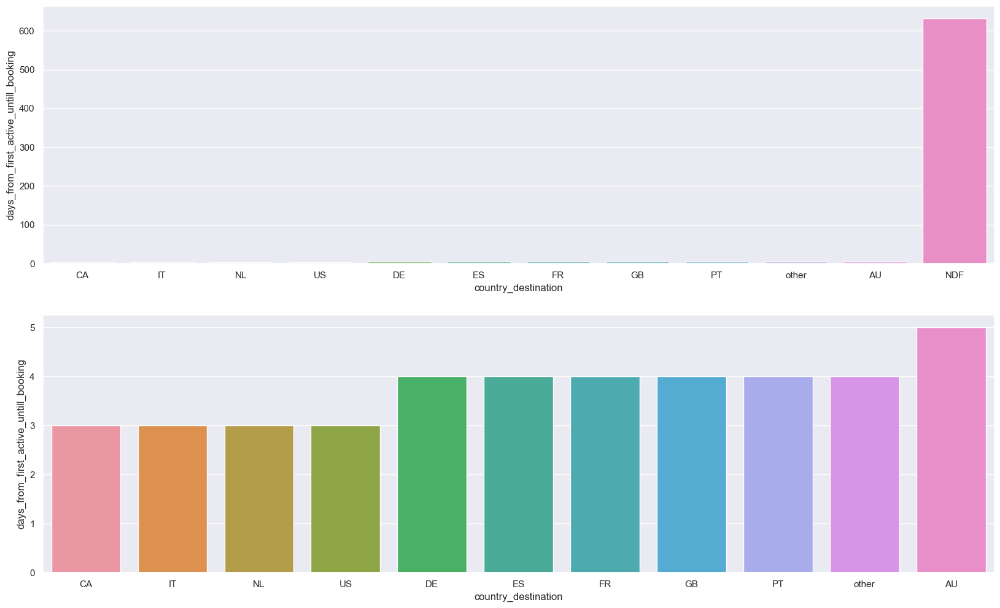

In [168]:
plt.figure( figsize=(20, 12 ) )
plt.subplot( 2, 1, 1 )
aux01 = df51[['days_from_first_active_untill_booking', 'country_destination']].groupby( 'country_destination' ).median().reset_index()
sns.barplot( x='country_destination', y='days_from_first_active_untill_booking',
           data=aux01.sort_values( 'days_from_first_active_untill_booking' ) )



plt.subplot( 2, 1, 2 )
aux02 = df51[ df51[ 'country_destination'] != 'NDF']
aux02 = aux02[['days_from_first_active_untill_booking', 'country_destination']].groupby( 'country_destination' ).median().reset_index()
sns.barplot( x='country_destination', y='days_from_first_active_untill_booking',
           data=aux02.sort_values( 'days_from_first_active_untill_booking' ) )



### H2.0 In all destinations, users take three days on average to register on the site.

**True** For all destinations, users takes around 2 days  to register on the site.

<AxesSubplot: xlabel='country_destination', ylabel='days_from_first_active_untill_account_created'>

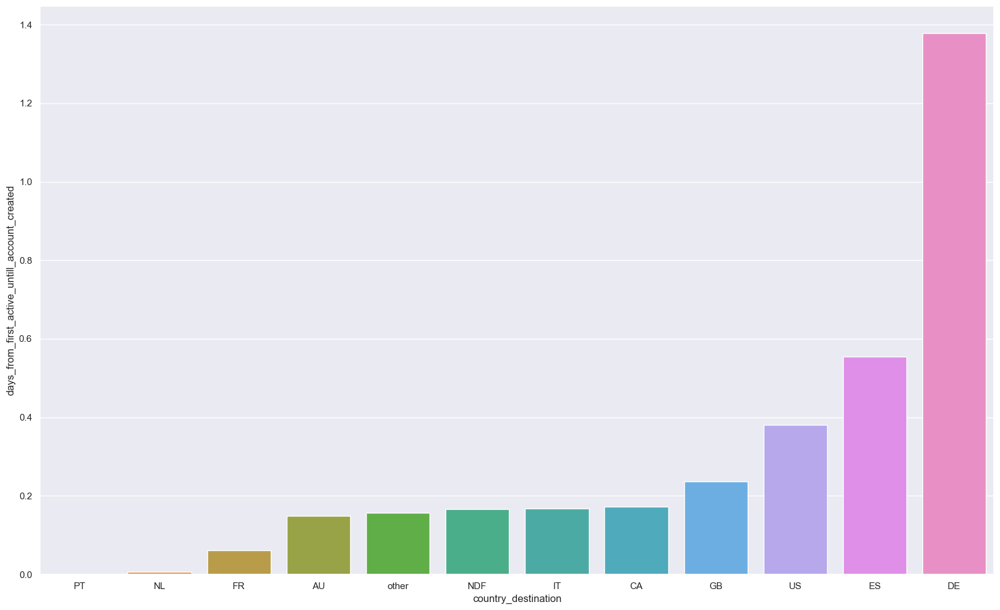

In [169]:
plt.figure( figsize=(20, 12 ) )
aux01 = df51[['days_from_first_active_untill_account_created', 'country_destination']].groupby( 'country_destination' ).mean().reset_index()
sns.barplot( x='country_destination', y='days_from_first_active_untill_account_created',
           data=aux01.sort_values( 'days_from_first_active_untill_account_created' ) )


### H3.0 The volume of annual bookings made during the summer increases by 20% for destinations within the USA.

<AxesSubplot: xlabel='year_first_booking', ylabel='delta'>

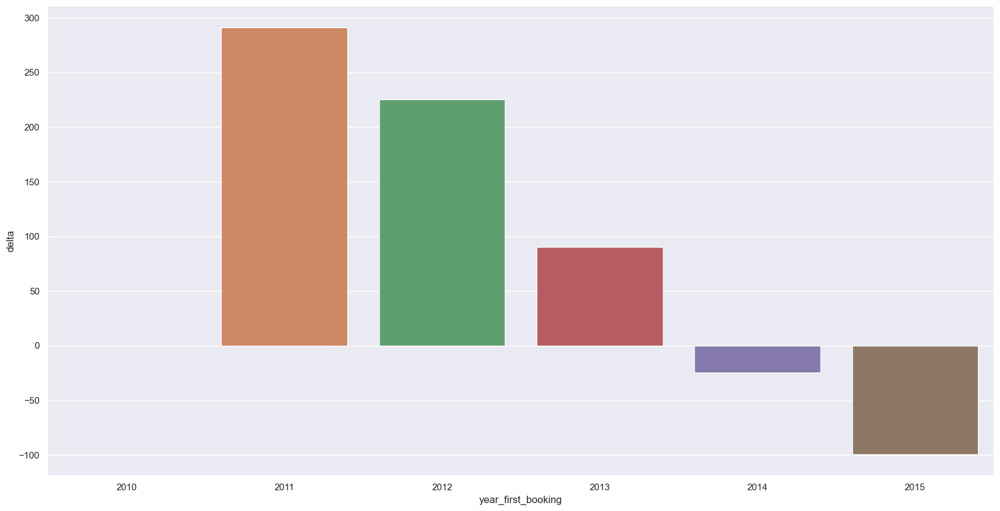

In [357]:
aux01 = df52[['year_first_booking', 'month_first_booking', 'country_destination']].\
    groupby( ['year_first_booking', 'month_first_booking','country_destination'] ).\
    size().reset_index().rename(  columns={0:'count'} )

# select only summer
aux01 = aux01[(aux01['month_first_booking'].isin( [6, 7, 8,9] ) ) & (aux01['country_destination'] == 'US') ]

aux02 = aux01[['year_first_booking', 'count']].groupby( 'year_first_booking' ).sum().reset_index()

aux02['delta'] = 100 * aux02['count'].pct_change().fillna( 0 )


plt.figure( figsize=(20, 10) )
sns.barplot( x='year_first_booking', y='delta', data=aux02 )


### H4.0 Female users made 10% more bookings to countries outside of the USA.
**False** 40% of womens are booking to countries outside of USA.

,gender,day_first_booking,country_destination
0,-unknown-,29,NDF
1,MALE,29,NDF
2,FEMALE,2,US
3,FEMALE,8,other
4,-unknown-,18,US


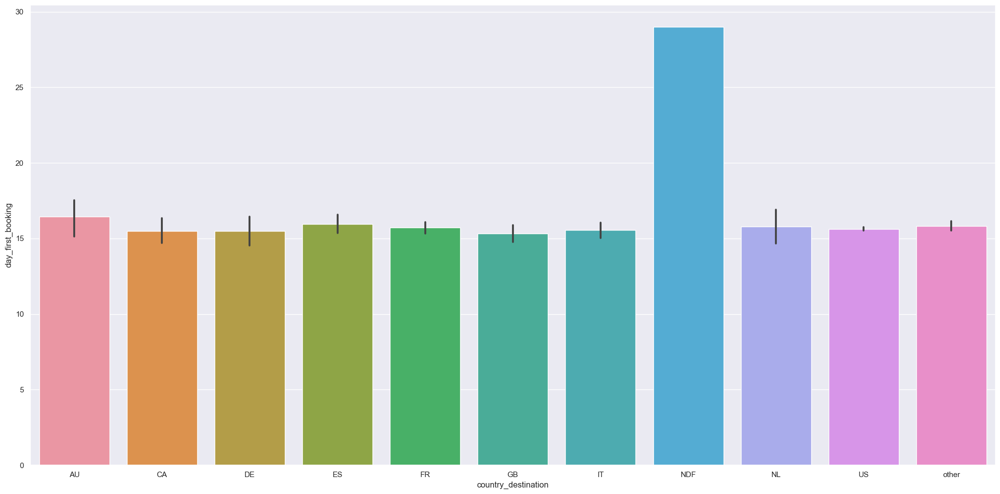

In [392]:
aux01 = df51[['gender', 'day_first_booking', 'country_destination']]
aux02 = aux01[(aux01['gender']== 'FEMALE' ) & (aux01['country_destination']!= 'PT') & (aux01['day_first_booking'] > 0) ]
sns.barplot( x='country_destination', y='day_first_booking', data=aux02.sort_values( 'country_destination' ) )

aux01.head()



In [408]:
total_customers = len( aux01 )

other = aux01[ (aux01['country_destination']!= 'US') ].count()
us = aux01[ (aux01['country_destination'] == 'US') ].count()

dif = other - us
print( ' Percentage of Womens Booking Reservations Outside of USA: {: .2f}%'.format( 100 * dif['country_destination'] / total_customers ) ) 




 Percentage of Womens Booking Reservations Outside of USA:  41.14%


### H5.0 The Google marketing channel represents 40% of resevations for countries outside the USA.
**False** The google markiting channel represents only 24.32% of resevations.

In [316]:
total_customers = len( df51 )

direct = len(df51[df51['affiliate_provider'] == 'direct'])
print( ' Direct Representation Resevations: {: .2f}%'.format(  100 * direct / total_customers ) ) 


google = len(df51[df51['affiliate_provider'] == 'google'])
print( ' Google Representation Resevations: {: .2f}%'.format(  100 * google / total_customers ) ) 


other = len(df51[df51['affiliate_provider'] == 'other'])
print( ' Others Representation Resevations: {: .2f}%'.format(  100 * other / total_customers ) ) 




 Direct Representation Resevations:  64.59%
 Google Representation Resevations:  24.32%
 Others Representation Resevations:  5.74%


<AxesSubplot: xlabel='affiliate_provider', ylabel='country_destination'>

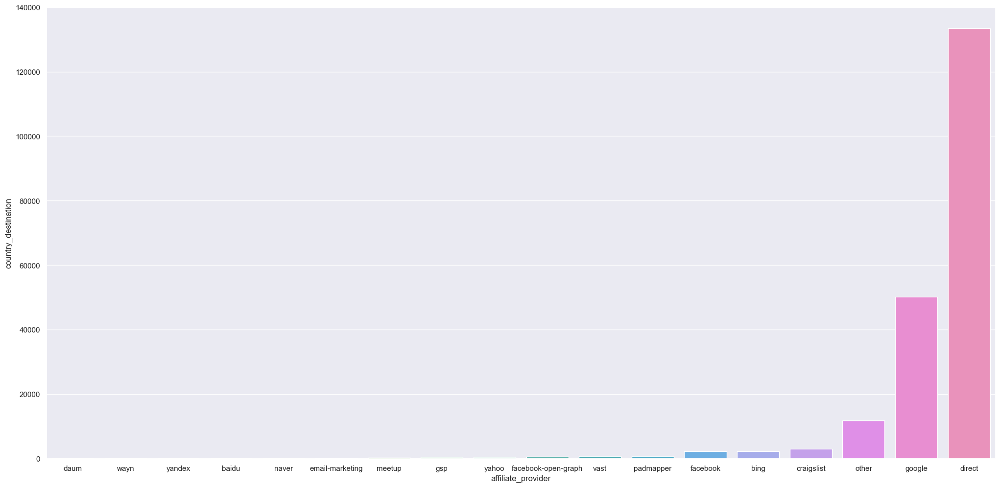

In [317]:
aux01 = df51[['affiliate_provider', 'country_destination']].groupby( 'affiliate_provider' ).count().reset_index()
sns.barplot( x='affiliate_provider', y='country_destination', data=aux01.sort_values( 'country_destination' ) )



### H6.0 The destination USA represents more than 20% on all channels.
**False** The channel NDF represents 28.56% more than all channels.

In [350]:
total_customers = len( df51 )

us = len(df51[df51['country_destination'] == 'US'])
print( ' Representation of USA Destination: {: .2f}%'.format(  100 * us / total_customers ) ) 


ndf = len(df51[df51['country_destination'] == 'NDF'])
print( ' Representation of NFD Destinations: {: .2f}%'.format(  100 * ndf / total_customers ) ) 


other = len(df51[df51['country_destination'] == 'other'])
print( ' Representation of Others Destinations: {: .2f}%'.format(  100 * other / total_customers ) ) 


dif = ndf - us
print( ' Diference between NDF and USA: {: .2f}%'.format(    100 * dif / total_customers ) ) 



 Representation of USA Destination:  29.43%
 Representation of NFD Destinations:  57.99%
 Representation of Others Destinations:  4.81%
 Diference between NFD and USA:  28.56%


<AxesSubplot: xlabel='country_destination', ylabel='day_first_booking'>

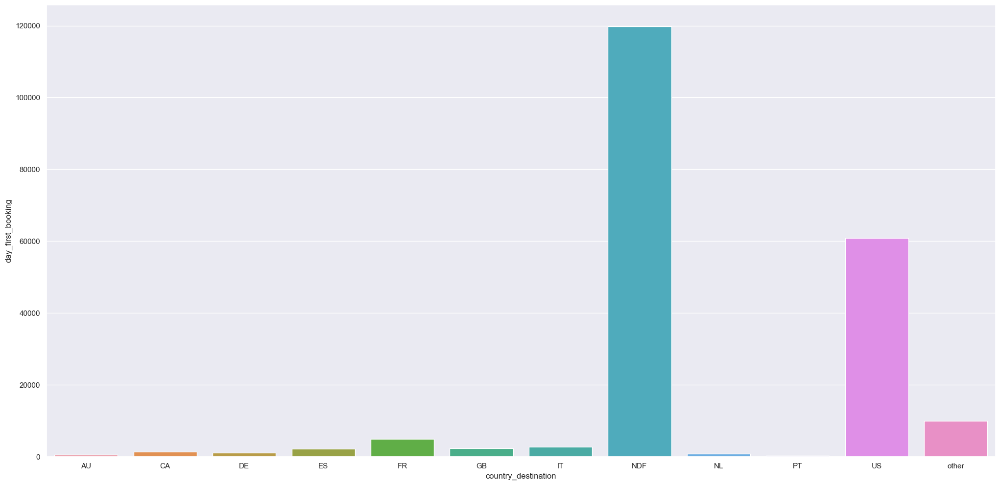

In [340]:
aux01 = df51[['day_first_booking', 'country_destination']].groupby( 'country_destination' ).count().reset_index()
sns.barplot( x='country_destination', y='day_first_booking', data=aux01.sort_values( 'country_destination' ) )



### H7.0 The average age of people is 35 years in all destinations.
**False** The averange age is of 40 years for most destinations.

,country_destination,age
0,AU,40.186312
1,CA,40.470758
2,DE,39.510165
3,ES,38.911484
4,FR,40.747388


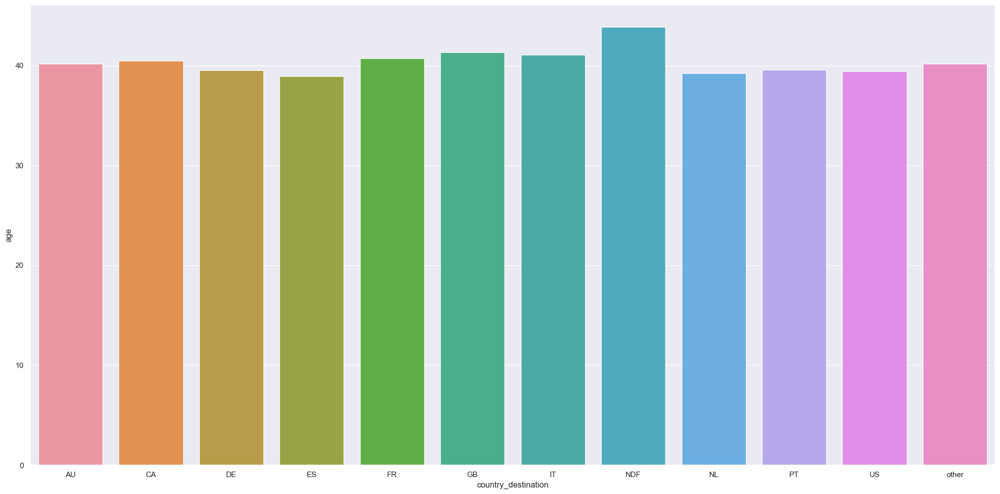

In [307]:
aux01 = df51[['age', 'country_destination']].groupby( 'country_destination' ).mean().reset_index()
sns.barplot( x='country_destination', y='age', data=aux01.sort_values( 'country_destination' ) )

aux01.head()

### H8.0 The percentage of users who use the site in American English have an accommodation reservation in any destination that is more than 90%.

**True** The percentage of users using English language is of 96.63%

In [301]:
english = len(df51[df51['language'] == 'en'])
total_customers = len( df51 )
print( ' Percentage of users using English Language: {: .2f}%'.format(  100 * english / total_customers ) ) 


chinese = len(df51[df51['language'] == 'zh'])
total_customers = len( df51 )
print( ' Percentage of users using Chinese Language: {: .2f}%'.format(  100 * chinese / total_customers ) ) 


french = len(df51[df51['language'] == 'fr'])
total_customers = len( df51 )
print( ' Percentage of users using French Language: {: .2f}%'.format(  100 * french / total_customers ) ) 


spanish = len(df51[df51['language'] == 'es'])
total_customers = len( df51 )
print( ' Percentage of users using Spanish Language: {: .2f}%'.format(  100 * spanish / total_customers ) ) 




 Percentage of users using English Language:  96.63%
 Percentage of users using Chinese Language:  0.77%
 Percentage of users using French Language:  0.55%
 Percentage of users using Spanish Language:  0.43%


<AxesSubplot: xlabel='language', ylabel='country_destination'>

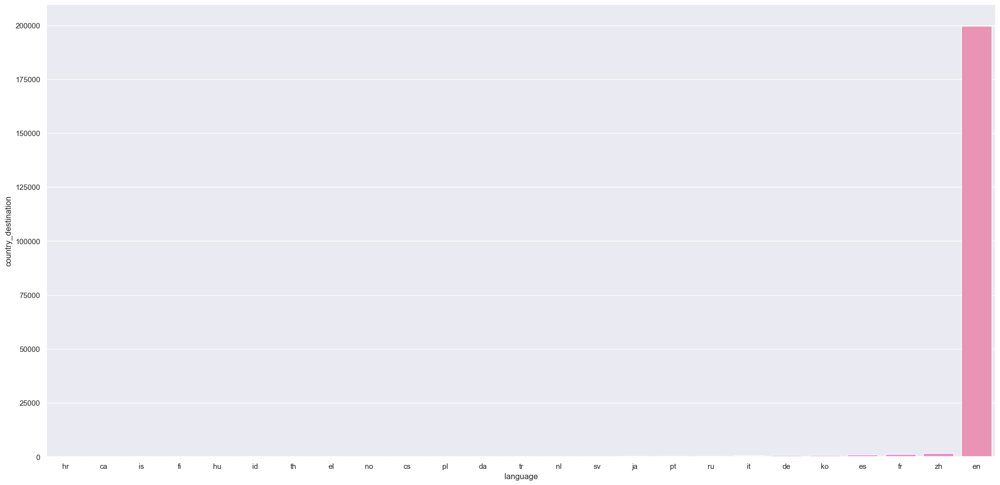

In [299]:
aux01 = df51[['language', 'country_destination']].groupby( 'language' ).count().reset_index()
sns.barplot( x='language', y='country_destination',
           data=aux01.sort_values( 'country_destination' ) )




### H9.0 The number of Airbnb reservations has increased over the years.
**True** The airbnb has increased to 120,000 resevations of the last year from database.

<AxesSubplot: xlabel='year_first_booking', ylabel='Count'>

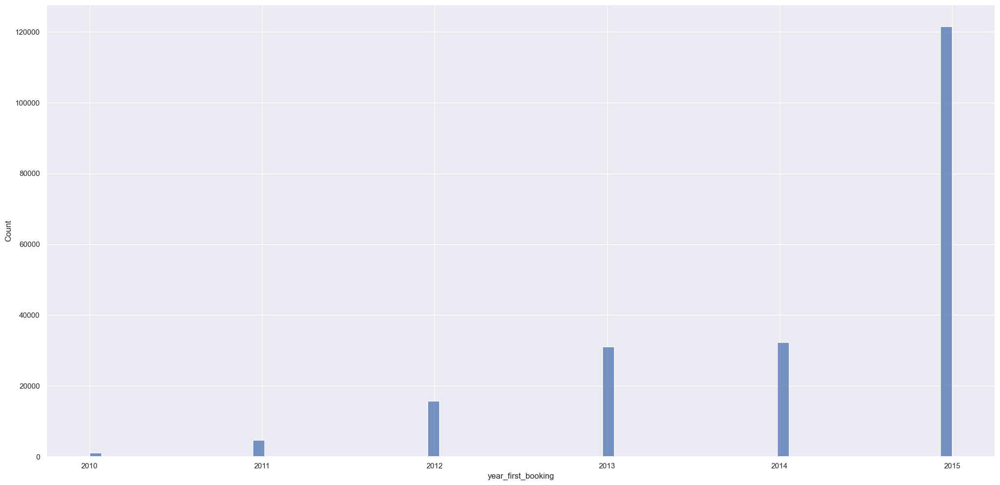

In [279]:

sns.histplot( df51['year_first_booking'])

## 5.3  Variable Impact ( Balanced dataset )

## 5.3.1 Univariate Analysis

In [172]:
 from pandas_profiling import ProfileReport

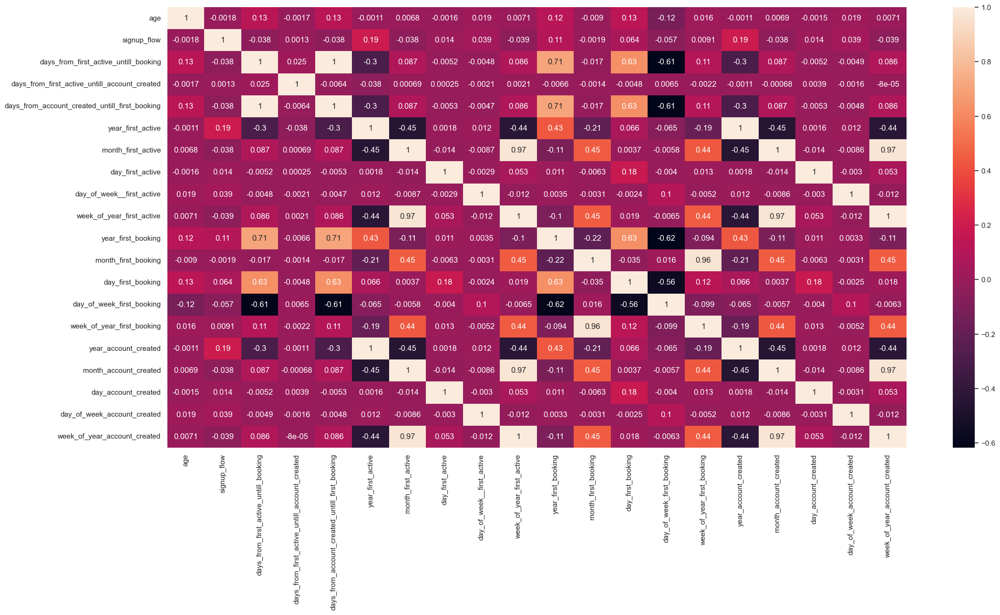

In [289]:
correlation = df51.corr (method = 'pearson')
sns.heatmap (correlation, annot = True);

In [275]:
# profile = ProfileReport( df51, title='Airbnb Booking' )
# profile.to_file( output_file='airbnb_booking_cleaning.html')

profile = ProfileReport( df51 )
profile.to_notebook_iframe( )

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

### 5.3.2 Multvariate Analysis

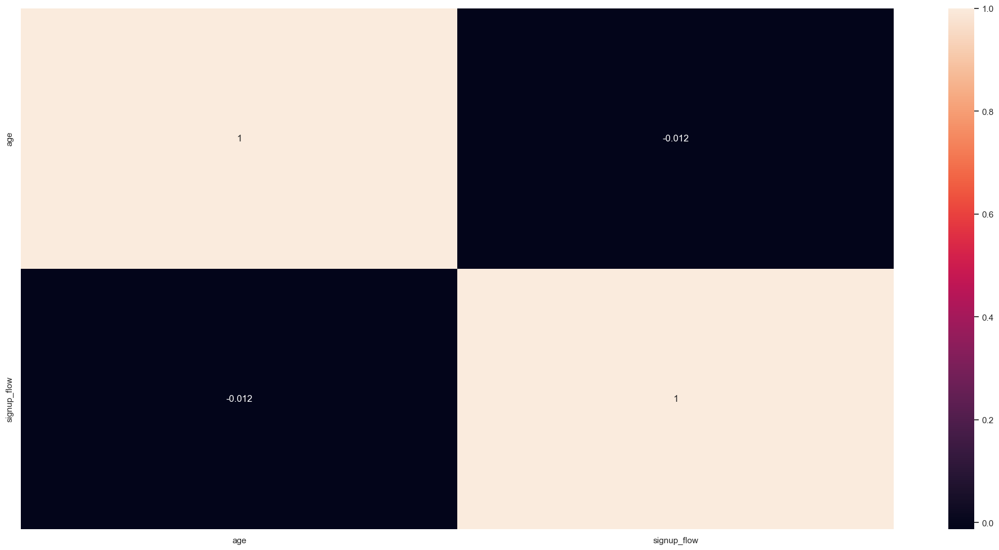

In [160]:
correlation = num_attributes.corr (method = 'pearson')
sns.heatmap (correlation, annot = True);

In [184]:
# High correlation
cols = [ 'days_from_first_active_untill_booking', 'year_first_active', 'month_first_active', 'day_first_active', 
'day_of_week__first_active', 'week_of_year_first_active', 'month_first_booking', 'month_account_created', 'year_first_booking',
'week_of_year_first_booking', 'affiliate_provider', 'first_browser', 'first_device_type', 'language']

df51_aux = df51.drop( cols, axis=1 )

# 6.0 Data Preparation

In [223]:
df6 =  df51_aux.copy()

df6.shape

(206593, 16)

## 6.1 Rescaling

In [224]:
ss = pp.StandardScaler()
rs = pp.RobustScaler()
mms = pp.MinMaxScaler()

In [225]:
# age - Standarlization
df6['age'] = ss.fit_transform( df6[['age']].values )

# signup_flow - Robust Scaler
df6['signup_flow'] = rs.fit_transform( df6[['signup_flow']].values )

# days_from_first_active_untill_account_created - Robust Scaler
df6['days_from_first_active_untill_account_created'] = rs.fit_transform( df6[['days_from_first_active_untill_account_created']].values )

# days_from_account_created_untill_first_booking - Robust Scaler
df6['days_from_account_created_untill_first_booking'] = rs.fit_transform( df6[['days_from_account_created_untill_first_booking']].values )

# year_account_created - Min Max Scaler
df6['year_account_created'] = mms.fit_transform( df6[['year_account_created']].values )


## 6.2 Encolding

In [226]:
te = TargetEncoder()

In [228]:
# gender - One hot encolder
df6 = pd.get_dummies( df6, prefix=['gender'], columns=['gender'])

# signup_method -  One hot encolder
df6 = pd.get_dummies( df6, prefix=['signup_method'], columns=['signup_method'])

# signup_app - One hot encolder
df6 = pd.get_dummies( df6, prefix=['signup_app'], columns=['signup_app'])

# affiliate_channel - Target Encolder
c = { 'NDF':0, 'US':1, 'other':2, 'CA':3, 'FR':5, 'ES':6, 'GB':7, 'IT':7, 'PT':8, 'NL':9, 'DE':10, 'AU':11 }
df6['affiliate_channel'] = te.fit_transform( df6[['affiliate_channel']].values, df6['country_destination'].map(c) )

# first_affiliate_tracked - Target Encolder
df6['first_affiliate_tracked'] = te.fit_transform( df6[['first_affiliate_tracked']].values, df6['country_destination'].map(c) )

In [209]:
df6['country_destination'].drop_duplicates().tolist()

['NDF', 'US', 'other', 'CA', 'FR', 'ES', 'GB', 'IT', 'PT', 'NL', 'DE', 'AU']

## 6.3 Transformation

In [230]:
df6.dtypes

age                                               float64
signup_flow                                       float64
days_from_first_active_untill_account_created     float64
days_from_account_created_untill_first_booking    float64
day_first_booking                                   int64
day_of_week_first_booking                           int64
year_account_created                              float64
day_account_created                                 int64
day_of_week_account_created                         int64
week_of_year_account_created                        int64
affiliate_channel                                 float64
first_affiliate_tracked                           float64
country_destination                                object
gender_-unknown-                                    uint8
gender_FEMALE                                       uint8
gender_MALE                                         uint8
gender_OTHER                                        uint8
signup_method_

In [231]:
# week_of_year_account_created
df6['week_of_year_account_created_sin'] = df6['week_of_year_account_created'].apply( lambda x: np.sin( x * (2*np.pi/52) ) )
df6['week_of_year_account_created_cos'] = df6['week_of_year_account_created'].apply( lambda x: np.cos( x * (2*np.pi/52) ) )

# day_of_week_first_booking
df6['day_of_week_first_booking_sin'] = df6['day_of_week_first_booking'].apply( lambda x: np.sin( x * (2*np.pi/7) ) )
df6['day_of_week_first_booking_cos'] = df6['day_of_week_first_booking'].apply( lambda x: np.cos( x * (2*np.pi/7) ) )
#

# day_account_created
df6['day_account_created_sin'] = df6['day_account_created'].apply( lambda x: np.sin( x * (2*np.pi/31) ) )
df6['day_account_created_cos'] = df6['day_account_created'].apply( lambda x: np.cos( x * (2*np.pi/31) ) )
#

# day_of_week_account_created
df6['day_of_week_account_created_sin'] = df6['day_of_week_account_created'].apply( lambda x: np.sin( x * (2*np.pi/7) ) )
df6['day_of_week_account_created_cos'] = df6['day_of_week_account_created'].apply( lambda x: np.cos( x * (2*np.pi/7) ) )


In [178]:


# # dammy variable
# df5_dummy = pd.get_dummies( df5.drop( ['id', 'country_destination'], axis=1) )

# # join Id and Country destination
# df5 = pd.concat( [df4[['id', 'country_destination']], df4_dummy], axis=1 )

# 7.0  Features Selection

In [262]:
#cols_drop = ['date_account_created', 'timestamp_first_active', 'date_first_booking', 'first_active']

df7 = df6.copy()

# 8.0 Machine Learning Model

In [263]:
df8 = df7.copy()

In [264]:
x = df8.drop( 'country_destination', axis=1 )
y = df8[ 'country_destination' ].copy()

In [265]:
# split dataset into to training and test
x_train, x_test, y_train, y_test = ms.train_test_split( x, y, test_size=0.2, random_state = 42 )

## 8.1 Baseline Model

In [240]:
import random


country_destination_list = df1['country_destination'].drop_duplicates().sort_values().tolist()
k_num = y_test.shape[0]

country_destination_weight = df1['country_destination'].value_counts( normalize=True ).sort_index()

yhat_random = random.choices( population = country_destination_list,
                              weights = country_destination_weight,
                              k = k_num )
len( yhat_random )

41319

## 8.2 Baseline Model Performance 

Accuracy: 0.42600256540574555
Balance Accuracy: 0.08350222264283623
Kappa Score: -0.0028685341607113113
              precision    recall  f1-score   support

          AU       0.00      0.00      0.00        95
          CA       0.01      0.01      0.01       299
          DE       0.00      0.00      0.00       197
          ES       0.02      0.02      0.02       453
          FR       0.03      0.03      0.03       955
          GB       0.01      0.01      0.01       442
          IT       0.02      0.02      0.02       585
         NDF       0.58      0.58      0.58     24062
          NL       0.00      0.00      0.00       140
          PT       0.00      0.00      0.00        46
          US       0.29      0.29      0.29     12091
       other       0.05      0.05      0.05      1954

    accuracy                           0.43     41319
   macro avg       0.08      0.08      0.08     41319
weighted avg       0.43      0.43      0.43     41319



<AxesSubplot: title={'center': 'Confusion Matrix'}, xlabel='Predicted label', ylabel='True label'>

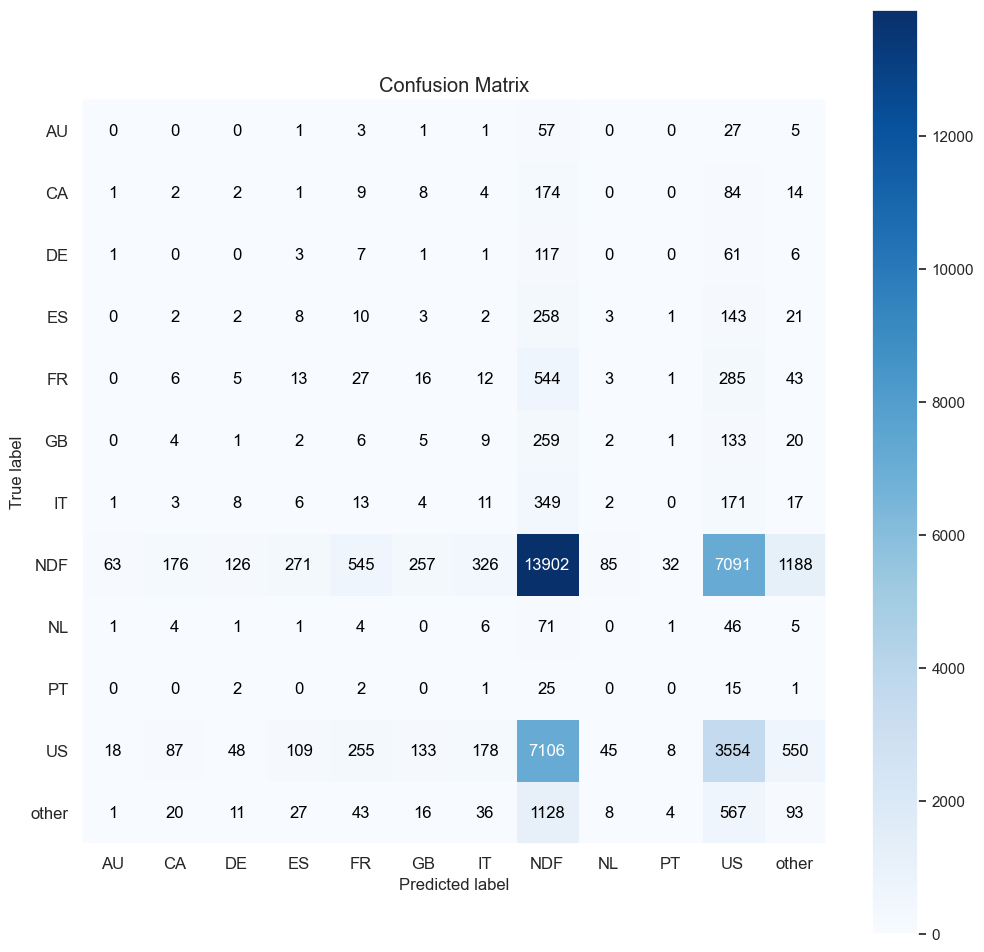

In [241]:
# Accuracy
acc_random = m.accuracy_score( y_test, yhat_random )
print( 'Accuracy: {}'.format( acc_random ) )


# Confusion Matrix
balance_acc_random = m.balanced_accuracy_score( y_test, yhat_random)
print( 'Balance Accuracy: {}'.format( balance_acc_random ) )


# kappa Metrics
kappa_random = m.cohen_kappa_score( y_test, yhat_random )
print( 'Kappa Score: {}'.format( kappa_random ) )

# classification report
print(m.classification_report( y_test, yhat_random ))

# Confusion Matrix
mt.plot_confusion_matrix( y_test, yhat_random, normalize=False, figsize=(12, 12) )




## 8.3 Neural Network - MLP

In [245]:
ohe = pp.OneHotEncoder()
y_train_nn = ohe.fit_transform( y_train.values.reshape( -1, 1 ) ).toarray()

In [246]:
print( 'Number of Rows: {}'.format( x_train.shape[0] ) )
print( 'Number of Features: {}'.format( x_train.shape[1] ) )
print( 'Number of Classes: {}'.format( y_train.nunique() ) )

Number of Rows: 165274
Number of Features: 31
Number of Classes: 12


In [247]:
# model definition
model = ml.Sequential()
model.add( l.Dense( 64, input_dim = x_train.shape[1], activation='relu' ) )
model.add( l.Dense( 12, activation='softmax' ) )

# model compile
model.compile( loss='categorical_crossentropy', optimizer='adam', metrics=['accuracy'] )

# train model
model.fit( x_train, y_train_nn, epochs=100 )

Epoch 1/100
5165/5165 [==============================] - 6s 1ms/step - loss: 0.5735 - accuracy: 0.8629
Epoch 2/100
5165/5165 [==============================] - 6s 1ms/step - loss: 0.5084 - accuracy: 0.8730
Epoch 3/100
5165/5165 [==============================] - 6s 1ms/step - loss: 0.4997 - accuracy: 0.8733
Epoch 4/100
5165/5165 [==============================] - 6s 1ms/step - loss: 0.4949 - accuracy: 0.8736
Epoch 5/100
5165/5165 [==============================] - 6s 1ms/step - loss: 0.4944 - accuracy: 0.8736
Epoch 6/100
5165/5165 [==============================] - 6s 1ms/step - loss: 0.4928 - accuracy: 0.8737
Epoch 7/100
5165/5165 [==============================] - 6s 1ms/step - loss: 0.4916 - accuracy: 0.8737
Epoch 8/100
5165/5165 [==============================] - 6s 1ms/step - loss: 0.4896 - accuracy: 0.8738
Epoch 9/100
5165/5165 [==============================] - 6s 1ms/step - loss: 0.4910 - accuracy: 0.8738
Epoch 10/100
5165/5165 [==============================] - 6s 1ms/step - l

5165/5165 [==============================] - 6s 1ms/step - loss: 0.4839 - accuracy: 0.8741
Epoch 80/100
5165/5165 [==============================] - 6s 1ms/step - loss: 0.4842 - accuracy: 0.8740
Epoch 81/100
5165/5165 [==============================] - 6s 1ms/step - loss: 0.4850 - accuracy: 0.8741
Epoch 82/100
5165/5165 [==============================] - 6s 1ms/step - loss: 0.4838 - accuracy: 0.8741
Epoch 83/100
5165/5165 [==============================] - 6s 1ms/step - loss: 0.4834 - accuracy: 0.8741
Epoch 84/100
5165/5165 [==============================] - 6s 1ms/step - loss: 0.4835 - accuracy: 0.8741
Epoch 85/100
5165/5165 [==============================] - 6s 1ms/step - loss: 0.4839 - accuracy: 0.8740
Epoch 86/100
5165/5165 [==============================] - 6s 1ms/step - loss: 0.4855 - accuracy: 0.8741
Epoch 87/100
5165/5165 [==============================] - 6s 1ms/step - loss: 0.4841 - accuracy: 0.8741
Epoch 88/100
5165/5165 [==============================] - 6s 1ms/step - loss:

## 8.4 NN Model Performance

In [248]:
# Prediction
pred_nn = model.predict( x_test )

# Invert Prediction
yhat_nn = ohe.inverse_transform( pred_nn )

# Prediction Prepare
y_test_nn = y_test.to_numpy()
yhat_nn = yhat_nn.reshape( 1, -1 )[0]


1292/1292 [==============================] - 1s 831us/step


Accuracy: 0.8747065514654275
Balance Accuracy: 0.16662660808215962
Kappa Score: 0.7674294312753402
              precision    recall  f1-score   support

          AU       0.00      0.00      0.00        95
          CA       0.00      0.00      0.00       299
          DE       0.00      0.00      0.00       197
          ES       0.00      0.00      0.00       453
          FR       0.00      0.00      0.00       955
          GB       0.00      0.00      0.00       442
          IT       0.00      0.00      0.00       585
         NDF       1.00      1.00      1.00     24062
          NL       0.00      0.00      0.00       140
          PT       0.00      0.00      0.00        46
          US       0.70      1.00      0.82     12091
       other       0.08      0.00      0.00      1954

    accuracy                           0.87     41319
   macro avg       0.15      0.17      0.15     41319
weighted avg       0.79      0.87      0.82     41319



<AxesSubplot: title={'center': 'Confusion Matrix'}, xlabel='Predicted label', ylabel='True label'>

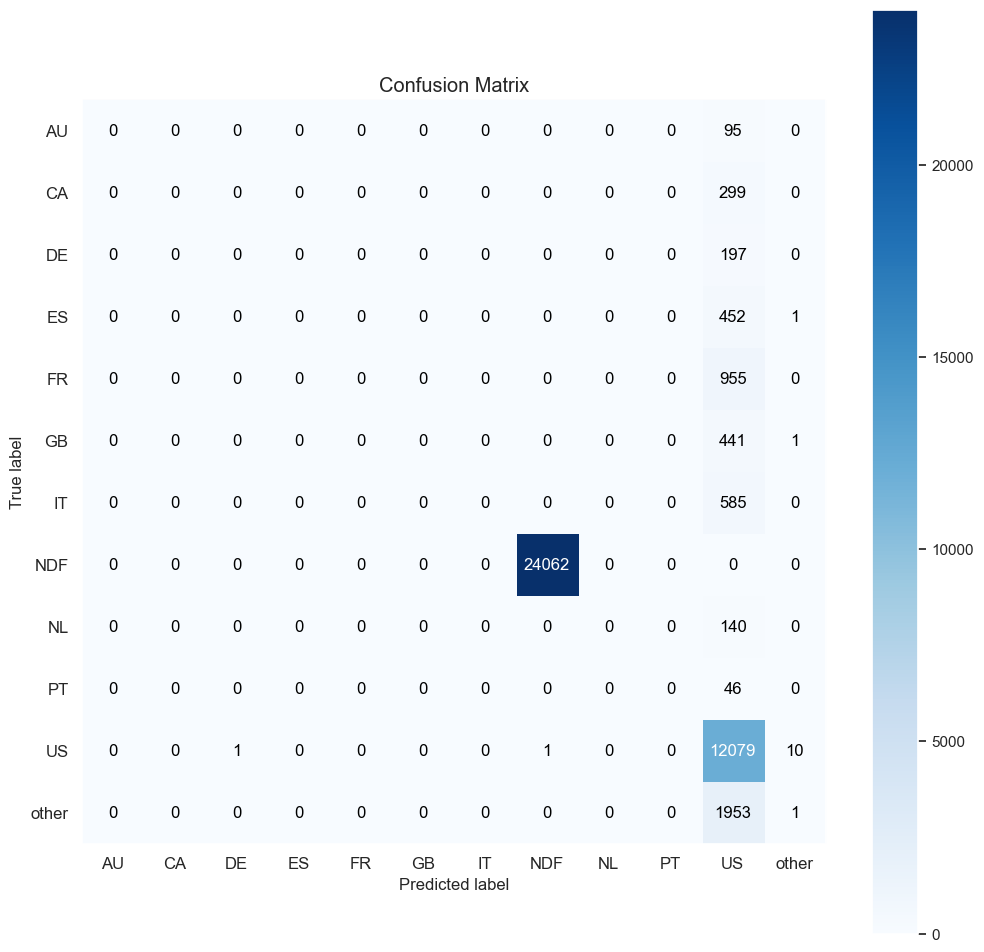

In [249]:

# Accuracy
acc_nn = m.accuracy_score( y_test_nn, yhat_nn )
print( 'Accuracy: {}'.format( acc_nn ) )


# Confusion Matrix
balance_acc_nn = m.balanced_accuracy_score( y_test_nn, yhat_nn)
print( 'Balance Accuracy: {}'.format( balance_acc_nn ) )


# kappa Metrics
kappa_nn = m.cohen_kappa_score( y_test_nn, yhat_nn )
print( 'Kappa Score: {}'.format( kappa_nn ) )

# classification report
print(m.classification_report( y_test_nn, yhat_nn ))

# Confusion Matrix
mt.plot_confusion_matrix( y_test_nn, yhat_nn, normalize=False, figsize=(12, 12) )



In [261]:
x_train.shape

(165274, 31)

## 8.5 NN Model Performance - Cross Validation

In [273]:
# gerate k-fold
num_folds = 5
kfold = ms.StratifiedKFold( n_splits=num_folds, shuffle=True, random_state=32 )

balanced_acc_list = []
kappa_acc_list = []

i = 1

for train_ix, val_ix in  kfold.split( x_train, y_train ):
    print( 'fold Number:{}/{}'.format(i, num_folds ) )

    # get fold
    x_train_fold = x_train.iloc[ train_ix ]
    y_train_fold = y_train.iloc[ train_ix ]
    
    x_val_fold =  x_train.iloc[ val_ix ]
    y_val_fold =  y_train.iloc[ val_ix ]
    
    # target
    ohe = pp.OneHotEncoder()
    y_train_fold_nn = ohe.fit_transform( y_train_fold.values.reshape( -1, 1 )).toarray()


    # model definition
    model = ml.Sequential()
    model.add( l.Dense( 256, input_dim=x_train.shape[1], activation='relu' ) )
    model.add( l.Dense( 11, activation='softmax' ) )

    # compile model
    model.compile( loss='sparse_categorical_crossentropy', optimizer='adam', metrics=['accuracy'] )


    # tranning model
    model.fit( x_train_fold, y_train_fold_nn, epochs=100, batch_size=32, verbose=0 )
    
    
    # prediction
    pred_nn = model.predict( x_val_fold )
    yhat_nn = ohe.inverse_transform( pred_nn )
    
    # prepare data
    y_test_nn = y_val_fold.to_numpy()
    yhat_nn = yhat_nn.reshape( -1, 1 )[0]


    # Metrics 



    # Balanced Accuracy
    balanced_acc_nn = m.balanced_accuracy_score( y_test_nn, yhat_nn )
    balanced_acc_list.append( balanced_acc_nn )

    # kappa metrics
    kappa_acc_nn = m.cohen_kappa_score( y_test_nn, yhat_nn )
    kappa_acc_list.append( kappa_acc_nn )
    
    i +- 1

fold Number:1/5


2023-04-11 12:14:49.472354: I tensorflow/core/common_runtime/executor.cc:1197] [/job:localhost/replica:0/task:0/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: logits and labels must have the same first dimension, got logits shape [32,11] and labels shape [384]
	 [[{{node sparse_categorical_crossentropy/SparseSoftmaxCrossEntropyWithLogits/SparseSoftmaxCrossEntropyWithLogits}}]]


InvalidArgumentError: Graph execution error:

Detected at node 'sparse_categorical_crossentropy/SparseSoftmaxCrossEntropyWithLogits/SparseSoftmaxCrossEntropyWithLogits' defined at (most recent call last):
    File "/Users/adriele/opt/anaconda3/envs/env_pa001/lib/python3.9/runpy.py", line 197, in _run_module_as_main
      return _run_code(code, main_globals, None,
    File "/Users/adriele/opt/anaconda3/envs/env_pa001/lib/python3.9/runpy.py", line 87, in _run_code
      exec(code, run_globals)
    File "/Users/adriele/opt/anaconda3/envs/env_pa001/lib/python3.9/site-packages/ipykernel_launcher.py", line 17, in <module>
      app.launch_new_instance()
    File "/Users/adriele/opt/anaconda3/envs/env_pa001/lib/python3.9/site-packages/traitlets/config/application.py", line 1043, in launch_instance
      app.start()
    File "/Users/adriele/opt/anaconda3/envs/env_pa001/lib/python3.9/site-packages/ipykernel/kernelapp.py", line 725, in start
      self.io_loop.start()
    File "/Users/adriele/opt/anaconda3/envs/env_pa001/lib/python3.9/site-packages/tornado/platform/asyncio.py", line 215, in start
      self.asyncio_loop.run_forever()
    File "/Users/adriele/opt/anaconda3/envs/env_pa001/lib/python3.9/asyncio/base_events.py", line 601, in run_forever
      self._run_once()
    File "/Users/adriele/opt/anaconda3/envs/env_pa001/lib/python3.9/asyncio/base_events.py", line 1905, in _run_once
      handle._run()
    File "/Users/adriele/opt/anaconda3/envs/env_pa001/lib/python3.9/asyncio/events.py", line 80, in _run
      self._context.run(self._callback, *self._args)
    File "/Users/adriele/opt/anaconda3/envs/env_pa001/lib/python3.9/site-packages/ipykernel/kernelbase.py", line 513, in dispatch_queue
      await self.process_one()
    File "/Users/adriele/opt/anaconda3/envs/env_pa001/lib/python3.9/site-packages/ipykernel/kernelbase.py", line 502, in process_one
      await dispatch(*args)
    File "/Users/adriele/opt/anaconda3/envs/env_pa001/lib/python3.9/site-packages/ipykernel/kernelbase.py", line 409, in dispatch_shell
      await result
    File "/Users/adriele/opt/anaconda3/envs/env_pa001/lib/python3.9/site-packages/ipykernel/kernelbase.py", line 729, in execute_request
      reply_content = await reply_content
    File "/Users/adriele/opt/anaconda3/envs/env_pa001/lib/python3.9/site-packages/ipykernel/ipkernel.py", line 422, in do_execute
      res = shell.run_cell(
    File "/Users/adriele/opt/anaconda3/envs/env_pa001/lib/python3.9/site-packages/ipykernel/zmqshell.py", line 540, in run_cell
      return super().run_cell(*args, **kwargs)
    File "/Users/adriele/opt/anaconda3/envs/env_pa001/lib/python3.9/site-packages/IPython/core/interactiveshell.py", line 2961, in run_cell
      result = self._run_cell(
    File "/Users/adriele/opt/anaconda3/envs/env_pa001/lib/python3.9/site-packages/IPython/core/interactiveshell.py", line 3016, in _run_cell
      result = runner(coro)
    File "/Users/adriele/opt/anaconda3/envs/env_pa001/lib/python3.9/site-packages/IPython/core/async_helpers.py", line 129, in _pseudo_sync_runner
      coro.send(None)
    File "/Users/adriele/opt/anaconda3/envs/env_pa001/lib/python3.9/site-packages/IPython/core/interactiveshell.py", line 3221, in run_cell_async
      has_raised = await self.run_ast_nodes(code_ast.body, cell_name,
    File "/Users/adriele/opt/anaconda3/envs/env_pa001/lib/python3.9/site-packages/IPython/core/interactiveshell.py", line 3400, in run_ast_nodes
      if await self.run_code(code, result, async_=asy):
    File "/Users/adriele/opt/anaconda3/envs/env_pa001/lib/python3.9/site-packages/IPython/core/interactiveshell.py", line 3460, in run_code
      exec(code_obj, self.user_global_ns, self.user_ns)
    File "/var/folders/pc/6sglrsq96ws5kp74fjj4j02h0000gn/T/ipykernel_68807/2223108029.py", line 35, in <module>
      model.fit( x_train_fold, y_train_fold_nn, epochs=100, batch_size=32, verbose=0 )
    File "/Users/adriele/opt/anaconda3/envs/env_pa001/lib/python3.9/site-packages/keras/utils/traceback_utils.py", line 65, in error_handler
      return fn(*args, **kwargs)
    File "/Users/adriele/opt/anaconda3/envs/env_pa001/lib/python3.9/site-packages/keras/engine/training.py", line 1685, in fit
      tmp_logs = self.train_function(iterator)
    File "/Users/adriele/opt/anaconda3/envs/env_pa001/lib/python3.9/site-packages/keras/engine/training.py", line 1284, in train_function
      return step_function(self, iterator)
    File "/Users/adriele/opt/anaconda3/envs/env_pa001/lib/python3.9/site-packages/keras/engine/training.py", line 1268, in step_function
      outputs = model.distribute_strategy.run(run_step, args=(data,))
    File "/Users/adriele/opt/anaconda3/envs/env_pa001/lib/python3.9/site-packages/keras/engine/training.py", line 1249, in run_step
      outputs = model.train_step(data)
    File "/Users/adriele/opt/anaconda3/envs/env_pa001/lib/python3.9/site-packages/keras/engine/training.py", line 1051, in train_step
      loss = self.compute_loss(x, y, y_pred, sample_weight)
    File "/Users/adriele/opt/anaconda3/envs/env_pa001/lib/python3.9/site-packages/keras/engine/training.py", line 1109, in compute_loss
      return self.compiled_loss(
    File "/Users/adriele/opt/anaconda3/envs/env_pa001/lib/python3.9/site-packages/keras/engine/compile_utils.py", line 265, in __call__
      loss_value = loss_obj(y_t, y_p, sample_weight=sw)
    File "/Users/adriele/opt/anaconda3/envs/env_pa001/lib/python3.9/site-packages/keras/losses.py", line 142, in __call__
      losses = call_fn(y_true, y_pred)
    File "/Users/adriele/opt/anaconda3/envs/env_pa001/lib/python3.9/site-packages/keras/losses.py", line 268, in call
      return ag_fn(y_true, y_pred, **self._fn_kwargs)
    File "/Users/adriele/opt/anaconda3/envs/env_pa001/lib/python3.9/site-packages/keras/losses.py", line 2078, in sparse_categorical_crossentropy
      return backend.sparse_categorical_crossentropy(
    File "/Users/adriele/opt/anaconda3/envs/env_pa001/lib/python3.9/site-packages/keras/backend.py", line 5660, in sparse_categorical_crossentropy
      res = tf.nn.sparse_softmax_cross_entropy_with_logits(
Node: 'sparse_categorical_crossentropy/SparseSoftmaxCrossEntropyWithLogits/SparseSoftmaxCrossEntropyWithLogits'
logits and labels must have the same first dimension, got logits shape [32,11] and labels shape [384]
	 [[{{node sparse_categorical_crossentropy/SparseSoftmaxCrossEntropyWithLogits/SparseSoftmaxCrossEntropyWithLogits}}]] [Op:__inference_train_function_2681934]

In [ ]:
print( 'Avg Balanced Accuracy: {} +/- {}'.format( np.round( np.mean( balanced_acc_list ), 2 ),
                                                  np.round( np.std( balanced_acc_list ),  4 ) ) )

print( 'Avg Kappa: {} +/- {}'.format( np.round( np.mean( kappa_acc_list ), 2 ),
                                      np.round( np.std( kappa_acc_list ),  4 ) ) )